In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import os

In [2]:
working_folder = "C:/Users/Enrico/OneDrive - UGent/run-ionbot"
# dataset_name = 'PXD002057.v0.11.4'
# dataset_name = 'PXD005833.v0.11.4'
dataset_name = 'PXD014258.v0.11.4'
search = 'openprot'
X = "group-walk-mass-shifts-output.csv"

In [3]:
def plot_target_decoys(PATH, xrange=None, yrange=None, filtering=False):
    data3 = pd.read_csv(PATH, low_memory=False)
    
    if filtering=='global':
        data3 = data3[data3['q.value']<.01].copy(deep=True)
    elif filtering=='groupwalk':
        data3 = data3[data3.group_qval<.01].copy(deep=True)
    elif filtering=='custom':
        try:
            data3 = data3[data3.custom_filter_pass].copy(deep=True)
        except:
            data3 = data3[data3.custom_q<.01].copy(deep=True)
    elif filtering: 
        # gives error if filtering is not False
        print(f'Error! Filtering = {filtering}')
        return filtering
        
    for (c,m),df in data3.groupby(['isCanonical','isModified']).__iter__():
        if c=='Contam':
            continue
        tmp = df.database.value_counts()
        try:
            fdr = tmp['D']/tmp['T']
            # fdr = (2*tmp['D'])/(tmp['D']+tmp['T'])
        except:
            fdr = 0
            tmp['D'] = 0
        fig = px.histogram(df, x='psm_score', color='database', nbins=100, 
                           range_x=xrange, range_y=yrange,
                           title=f"{dataset_name} | {c} {m} FDR = {fdr:.2%} [T={tmp['T']};D={tmp['D']}]")
        fig.show()

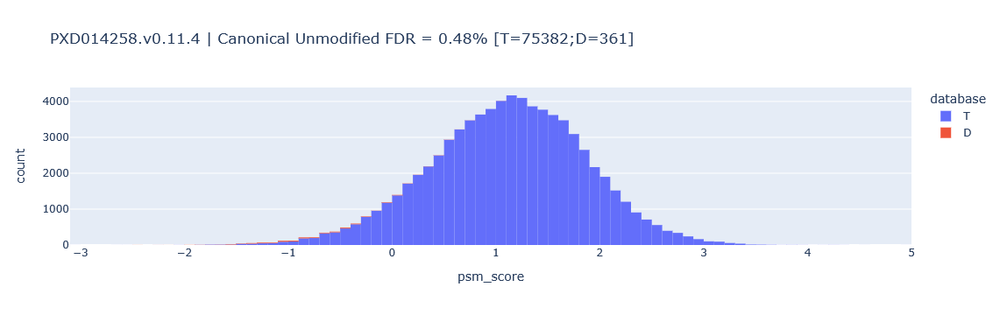

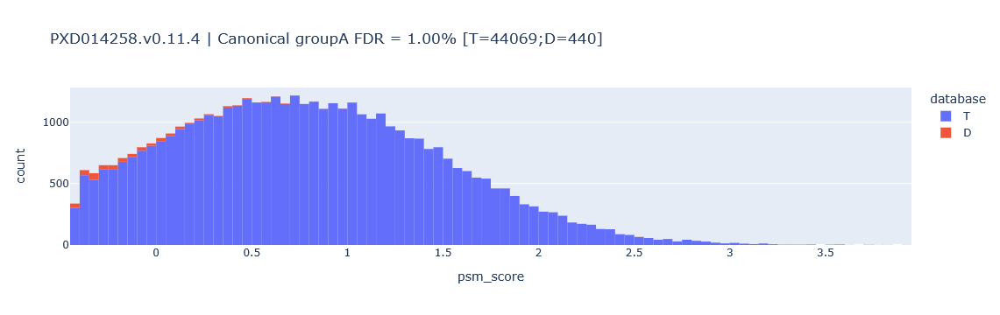

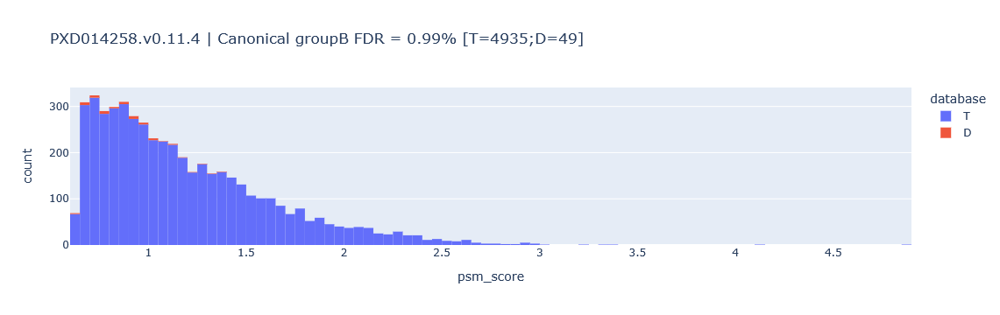

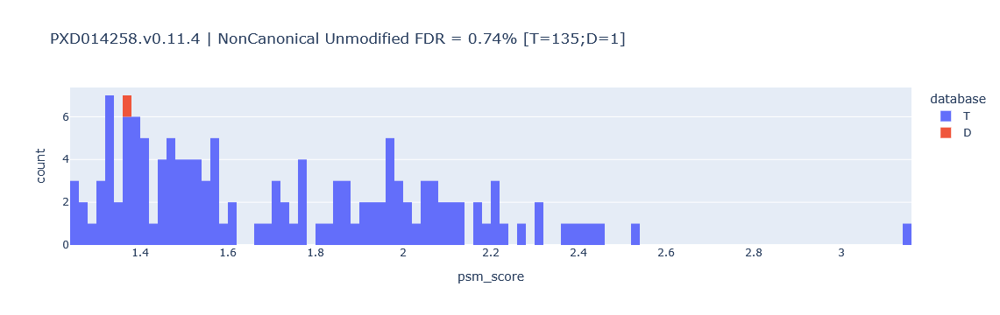

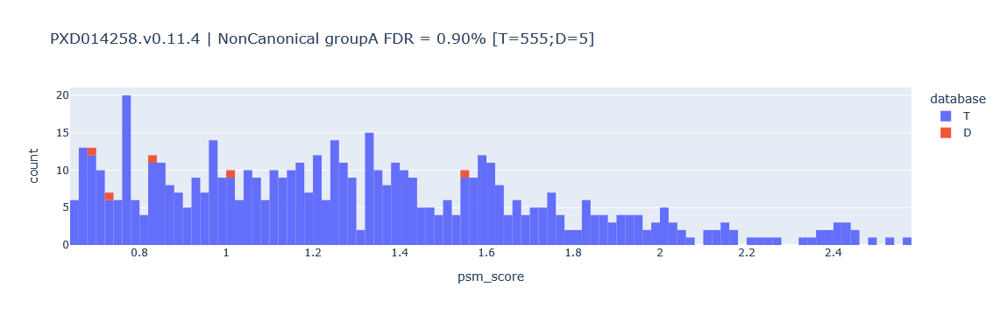

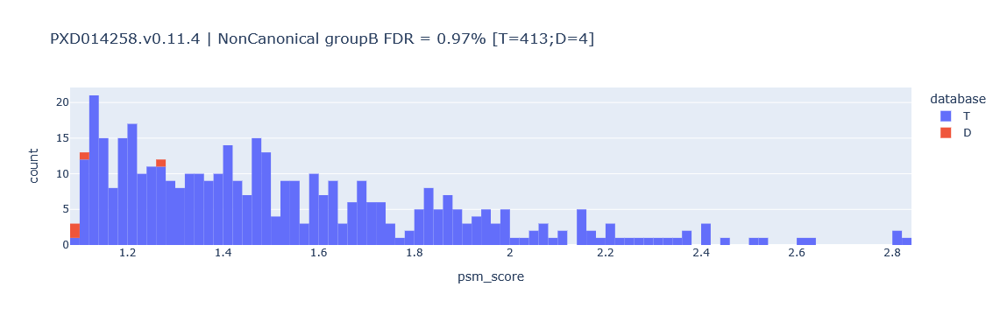

In [4]:
# "manual" FDR filtering
plot_target_decoys(os.path.join(working_folder, dataset_name, f"{dataset_name}-{search}", X),
                   # xrange=[0,7], yrange=[0,1000],
                   filtering='custom')

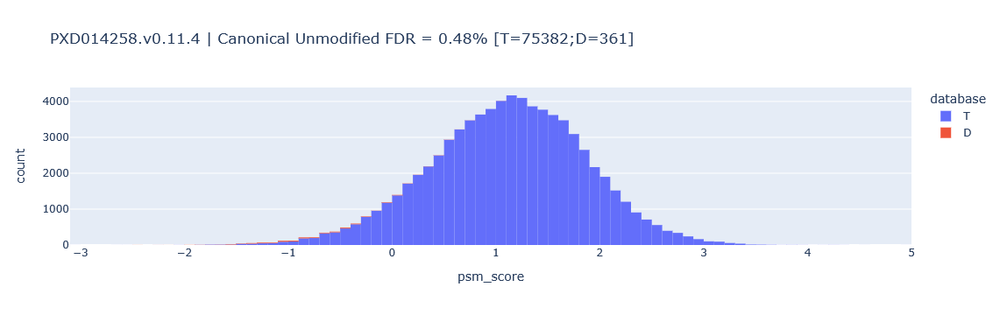

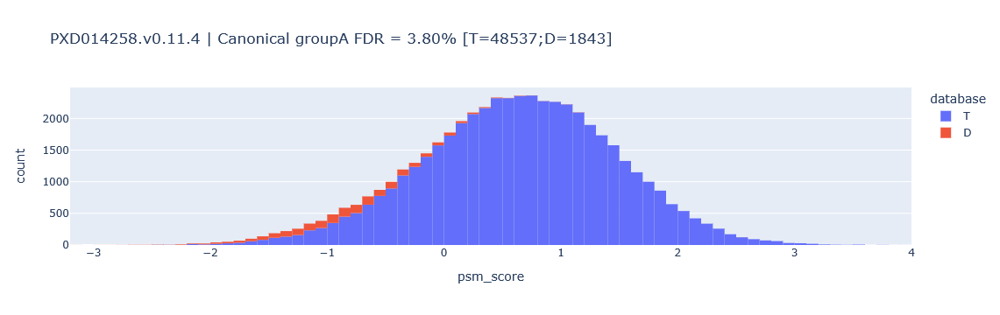

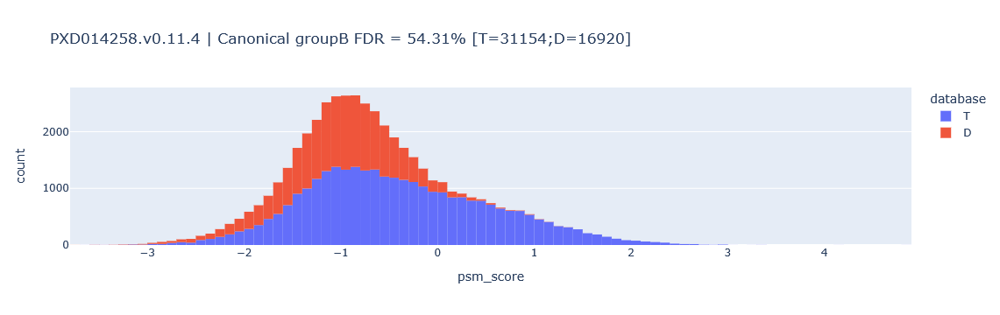

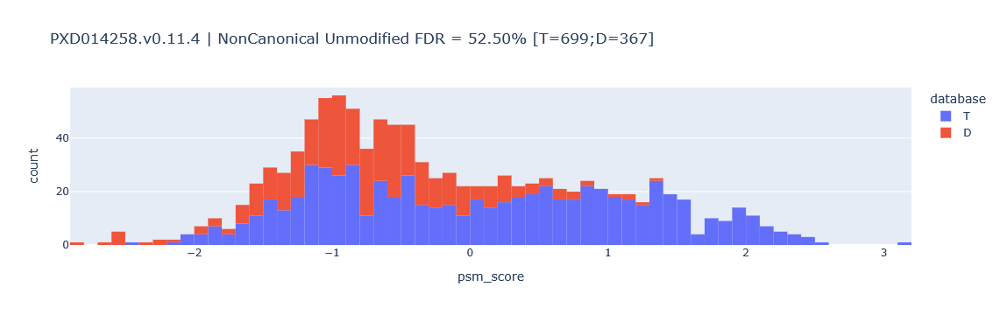

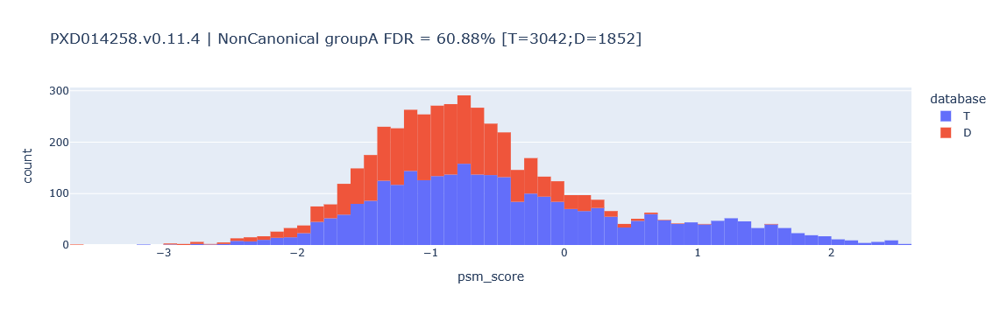

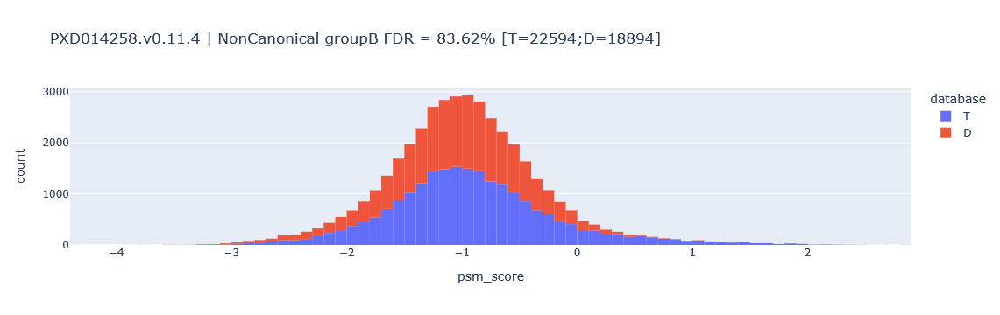

In [5]:
# group FDR, no filtering
plot_target_decoys(os.path.join(working_folder, dataset_name, f"{dataset_name}-{search}", X))

In [6]:
# group FDR, filtering on ionbot qvalue
# Note how the real FDR is different in the different groups despite filtering on the same qvalue threshold
plot_target_decoys(os.path.join(working_folder, dataset_name, f"{dataset_name}-{search}", X), 
                   filtering='global')

In [7]:
# group FDR, filtering on group-walk-corrected qvalue
# FDR values are now closer to 1%, still not perfect
plot_target_decoys(os.path.join(working_folder, dataset_name, f"{dataset_name}-{search}", X), 
                   filtering='groupwalk')

----

In [8]:
# Auto save & export notebook to html!!

from ipylab import JupyterFrontEnd
import subprocess, time

app = JupyterFrontEnd()
app.commands.execute('docmanager:save')
time.sleep(5) 

command = ['jupyter', 'nbconvert', 'group-wise-FDR-view.ipynb', '--to', 'html', '--output', 
           os.path.join('publication-data', dataset_name[:9], f'{dataset_name[:9]}-group-wise-FDR-mass-shifts.html')]
_ = subprocess.run(command)
print(_.returncode==0)

True
